<a href="https://colab.research.google.com/github/serkansokmen/ml-workspace/blob/master/Simpsons_Detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install turicreate

In [0]:
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}
!mkdir -p drive
!google-drive-ocamlfuse drive

In [0]:
root_dir = '/content/drive/Simpsons'

In [0]:
import os
os.chdir(root_dir)

In [5]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2018 NVIDIA Corporation
Built on Sat_Aug_25_21:08:01_CDT_2018
Cuda compilation tools, release 10.0, V10.0.130


In [4]:
# installing other packages to use GPU
# !apt install libnvrtc8.0
# uninstalling previosu versions of mxnet
!pip uninstall -y mxnet
# Installing the latest version of mxnet to work with turi create
!pip install mxnet-cu100==1.5.1.post0

     |████████████████████████████████| 540.1MB 31kB/s 
  Found existing installation: graphviz 0.10.1
    Uninstalling graphviz-0.10.1:
      Successfully uninstalled graphviz-0.10.1


In [0]:
import json
import turicreate as tc

# Name the model

In [0]:
model_name = "Simpsons_14_v4"
ig02_path = "./the-simpsons-dataset"

# Prepare data SFrame

In [0]:
annotations = None
with open(f'{ig02_path}/annotations.json') as j:
    annotations = json.load(j)
    annotations = tc.SFrame(annotations)

In [0]:
get_ipython().__class__.__name__ = "ZMQInteractiveShell"

In [0]:
annotations.explore()

/usr/local/lib/python3.6/dist-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,X1
0,"{'image': 'eae48ddf-52d4-4cf0-9cbb-686855a1314d.jpg', 'annotations': [{'label': 'Lisa Simpson', 'coordinates': {'x': 206, 'y': 220, 'width': 76, 'height': 75}}, {'label': 'Maggie Simpson', 'coordinates': {'x': 280, 'y': 246, 'width': 64, 'height': 67}}, {'label': 'Abraham Grampa Simpson', 'coordinates': {'x': 106, 'y': 145, 'width': 153, 'height': 198}}, {'label': 'Marge Simpson', 'coordinates': {'x': 261, 'y': 64, 'width': 80, 'height': 128}}]}"
1,"{'image': 'a1516701-cb05-41c2-ba84-f5c1678bde54.jpg', 'annotations': [{'label': 'Maggie Simpson', 'coordinates': {'x': 32, 'y': 182, 'width': 33, 'height': 42}}, {'label': 'Lisa Simpson', 'coordinates': {'x': 63, 'y': 274, 'width': 60, 'height': 55}}, {'label': 'Homer Simpson', 'coordinates': {'x': 183, 'y': 140, 'width': 53, 'height': 90}}, {'label': 'Bart Simpson', 'coordinates': {'x': 154, 'y': 258, 'width': 53, 'height': 76}}, {'label': 'Marge Simpson', 'coordinates': {'x': 83, 'y': 123, 'width': 53, 'height': 151}}]}"
2,"{'image': '63b78551-79ff-4a02-9660-5d46cb0fad25.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 39, 'y': 69, 'width': 78, 'height': 138}}]}"
3,"{'image': '15a358de-e415-45a0-8fc8-f72ddaa3a8d3.jpg', 'annotations': [{'label': 'Lisa Simpson', 'coordinates': {'x': 202, 'y': 195, 'width': 108, 'height': 114}}, {'label': 'Homer Simpson', 'coordinates': {'x': 242, 'y': 89, 'width': 29, 'height': 118}}]}"
4,"{'image': '87cc8a2b-75d5-4846-9e63-08cbff4660eb.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 93, 'y': 116, 'width': 186, 'height': 231}}]}"
5,"{'image': '19822579-5f32-4dc7-8411-19d37ce90e37.jpg', 'annotations': [{'label': 'Maggie Simpson', 'coordinates': {'x': 459, 'y': 288, 'width': 143, 'height': 151}}, {'label': 'Marge Simpson', 'coordinates': {'x': 409, 'y': 152, 'width': 252, 'height': 303}}]}"
6,"{'image': '78cae0d6-dd38-42aa-9153-41f4b6b62b2c.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 173, 'y': 149, 'width': 182, 'height': 297}}]}"
7,"{'image': '8554a856-91d9-46b7-a009-dfe1f0da4c9f.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 180, 'y': 110, 'width': 98, 'height': 219}}]}"
8,"{'image': '651c0c28-9751-4b67-b619-688fe65f570b.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 166, 'y': 150, 'width': 245, 'height': 299}}]}"
9,"{'image': '212a9de2-664f-4df3-8ebf-8d907a7ade79.jpg', 'annotations': [{'label': 'Marge Simpson', 'coordinates': {'x': 164, 'y': 178, 'width': 144, 'height': 238}}]}"


In [0]:
# Load all images in random order
images = tc.image_analysis.load_images(ig02_path,
                                       recursive=False,
                                       random_order=True)
info = images['path'].apply(lambda path: os.path.basename(path).split('.')[:2])
info = info.unpack().rename({'X.0': 'filename', 'X.1': 'extension'})

# remove unused column
images = images.add_columns(info)
del images['path']

data = images['filename'] \
    .apply(lambda name: annotations["X1"]
           .filter(lambda a: a["image"] == name + ".jpg")) \
    .unpack() \
    .unpack()
data["image"] = images["image"]

# There can be empty masks (which returns None), so let's get rid of those
data = data.dropna('annotations')

# data.explore()

In [0]:
data.save('the-simpsons-dataset.sframe')

In [0]:
# making sure that mxnet is working
# If you get an erroe here, you need to fix it before going forward
import mxnet as m2

In [0]:
import turicreate as tc

# Tell turicreate to use ALL available GPUs
tc.config.set_num_gpus(-1)

# Model

In [0]:
data = tc.load_sframe('the-simpsons-dataset.sframe')

In [11]:
data.head()

annotations,image
"[{'label': 'GroundskeeperWillie', 'coordinates': ...",Height: 416 Width: 576
"[{'label': 'CharlesMontgomery Burns', ...",Height: 386 Width: 256
"[{'label': 'LisaSimpson', 'coordinates': ...",Height: 509 Width: 255
"[{'label': 'ChiefWiggam', 'coordinates': ...",Height: 386 Width: 256
"[{'label': 'BartSimpson', 'coordinates': ...",Height: 480 Width: 320
"[{'label': 'EdnaKrappel', 'coordinates': ...",Height: 343 Width: 256
"[{'label': 'KentBrockman', 'coordinat ...",Height: 293 Width: 256
"[{'label': 'MargeSimpson', 'coordinates': ...",Height: 416 Width: 288
"[{'label': 'GroundskeeperWillie', 'coordinates': ...",Height: 368 Width: 496
"[{'label': 'MaggieSimpson', 'coordinates': ...",Height: 416 Width: 576


In [0]:
train_data, test_data = data.random_split(0.95)

In [13]:
train_data.print_rows(num_rows=10)

+-------------------------------+------------------------+
|          annotations          |         image          |
+-------------------------------+------------------------+
| [{'label': 'Groundskeeper ... | Height: 416 Width: 576 |
| [{'label': 'Charles Montgo... | Height: 386 Width: 256 |
| [{'label': 'Lisa Simpson',... | Height: 509 Width: 255 |
| [{'label': 'Chief Wiggam',... | Height: 386 Width: 256 |
| [{'label': 'Bart Simpson',... | Height: 480 Width: 320 |
| [{'label': 'Edna Krappel',... | Height: 343 Width: 256 |
| [{'label': 'Kent Brockman'... | Height: 293 Width: 256 |
| [{'label': 'Marge Simpson'... | Height: 416 Width: 288 |
| [{'label': 'Groundskeeper ... | Height: 368 Width: 496 |
| [{'label': 'Maggie Simpson... | Height: 416 Width: 576 |
+-------------------------------+------------------------+
[1596 rows x 2 columns]



# Check ground truth

In [0]:
train_data['image_with_ground_truth'] = \
    tc.object_detector.util.draw_bounding_boxes(train_data['image'], train_data['annotations'])

/usr/local/lib/python3.6/dist-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,annotations,image,image_with_ground_truth
0,"[{'label': 'Groundskeeper Willie', 'coordinates': {'x': 345, 'y': 122, 'width': 293, 'height': 227}}]",,
1,"[{'label': 'Charles Montgomery Burns', 'coordinates': {'x': 128, 'y': 142, 'width': 256, 'height': 284}}]",,
2,"[{'label': 'Lisa Simpson', 'coordinates': {'x': 114, 'y': 215, 'width': 122, 'height': 132}}]",,
3,"[{'label': 'Chief Wiggam', 'coordinates': {'x': 163, 'y': 111, 'width': 103, 'height': 97}}]",,
4,"[{'label': 'Bart Simpson', 'coordinates': {'x': 207, 'y': 132, 'width': 188, 'height': 258}}]",,
5,"[{'label': 'Edna Krappel', 'coordinates': {'x': 101, 'y': 88, 'width': 164, 'height': 175}}]",,
6,"[{'label': 'Kent Brockman', 'coordinates': {'x': 71, 'y': 109, 'width': 142, 'height': 219}}]",,
7,"[{'label': 'Marge Simpson', 'coordinates': {'x': 186, 'y': 161, 'width': 125, 'height': 234}}]",,
8,"[{'label': 'Groundskeeper Willie', 'coordinates': {'x': 237, 'y': 204, 'width': 319, 'height': 215}}]",,
9,"[{'label': 'Maggie Simpson', 'coordinates': {'x': 215, 'y': 161, 'width': 336, 'height': 322}}]",,

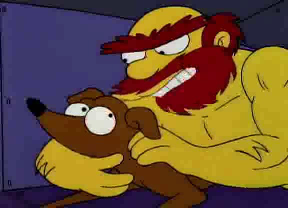
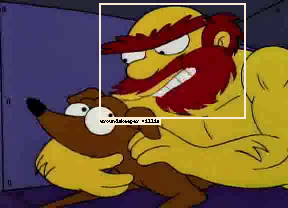
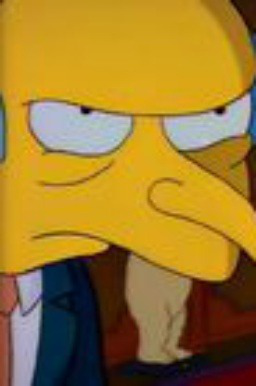
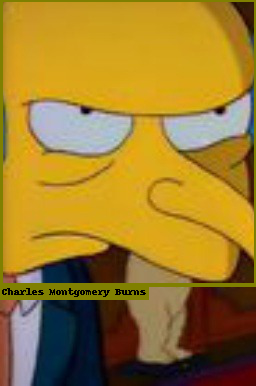
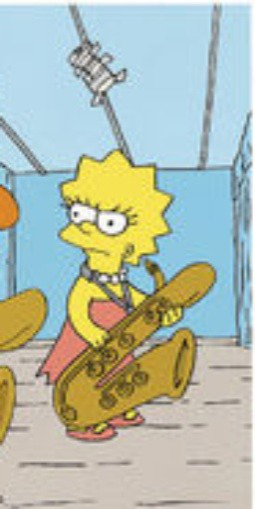
...
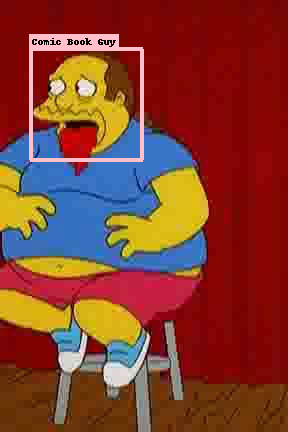
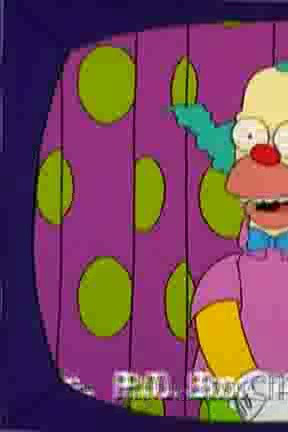
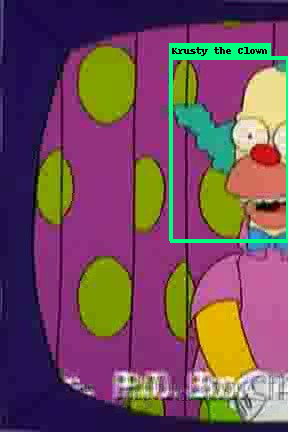
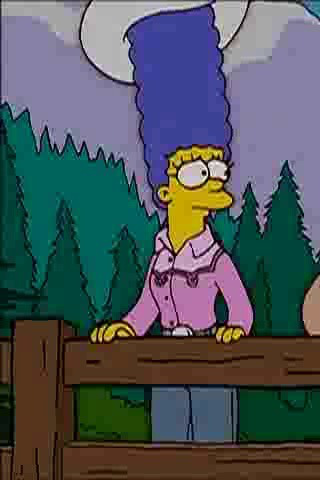
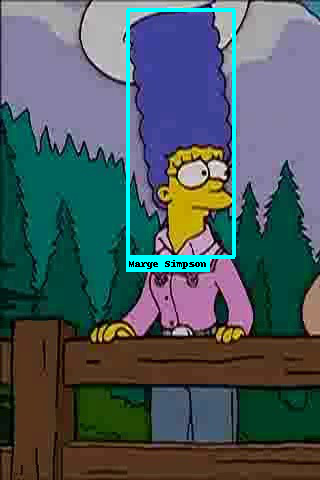

In [15]:
train_data.explore()

# Train the model

In [0]:
model = tc.object_detector.create(train_data, 
                                  feature="image", 
                                  annotations="annotations",
                                  max_iterations=14000,
                                  verbose=True)

         To fix this, please install the currently recommended version:

             pip uninstall -y mxnet && pip install mxnet==1.1.0

         If you want to use a CUDA GPU, then change 'mxnet' to 'mxnet-cu90' (adjust 'cu90' depending on your CUDA version):

Download completed: /var/tmp/model_cache/darknet.params
Setting 'batch_size' to 32
Using GPU to create model (Tesla P100-PCIE-16GB)
+--------------+--------------+--------------+
| Iteration    | Loss         | Elapsed Time |
+--------------+--------------+--------------+
| 1            | 9.818        | 32.5         |
| 11           | 9.898        | 46.9         |
| 21           | 9.617        | 57.3         |
| 27           | 9.247        | 67.5         |
| 33           | 8.893        | 78.0         |
| 42           | 8.605        | 88.2         |
| 49           | 8.315        | 98.2         |
| 50           | 8.288        | 119.6        |
| 60           | 7.730        | 131.6        |
| 70           | 7.429        | 143.4    

### Save the model

In [0]:
model.save(model_name + '.model')

In [0]:
model = tc.load_model(model_name + '.model')

# Predictions

In [17]:
predictions = model.predict(test_data, confidence_threshold=0.0, verbose=True)

Instructions for updating:
non-resource variables are not supported in the long term


In [18]:
predictions_stacked = tc.object_detector.util.stack_annotations(predictions)
predictions_stacked.print_rows(4)

+--------+------------------------+------------------------+--------------------+
| row_id |       confidence       |         label          |       height       |
+--------+------------------------+------------------------+--------------------+
|   0    | 4.497110057855025e-05  | Abraham Grampa Simpson | 201.11883544921875 |
|   0    | 3.591183849493973e-05  | Abraham Grampa Simpson | 73.74467468261719  |
|   0    | 2.9437303965096362e-05 | Abraham Grampa Simpson | 44.182796478271484 |
|   0    | 2.667510307219345e-05  | Abraham Grampa Simpson |  62.2703971862793  |
+--------+------------------------+------------------------+--------------------+
+--------------------+--------------------+--------------------+
|       width        |         x          |         y          |
+--------------------+--------------------+--------------------+
| 107.42863464355469 | 283.22576665878296 | 122.81168842315674 |
| 82.45707702636719  | 421.35645389556885 | 50.12386775016785  |
| 74.22447204589844

In [20]:
unstacked_predictions = tc.object_detector.util.unstack_annotations(
        predictions_stacked,
        num_rows=len(test_data))
unstacked_predictions.explore()

In [21]:
predictions.explore()

In [0]:
metrics = model.evaluate(test_data)

In [23]:
print('mAP: {:.1%}'.format(metrics['mean_average_precision_50']))

mAP: 99.9%


In [24]:
metrics

{'average_precision_50': {'Abraham Grampa Simpson': 1.0,
  'Barney Gumble': 1.0,
  'Bart Simpson': 1.0,
  'Charles Montgomery Burns': 1.0,
  'Chief Wiggam': 1.0,
  'Comic Book Guy': 1.0,
  'Edna Krappel': 1.0,
  'Groundskeeper Willie': 1.0,
  'Homer Simpson': 1.0,
  'Kent Brockman': 0.9821428656578064,
  'Krusty the Clown': 1.0,
  'Lisa Simpson': 1.0,
  'Maggie Simpson': 1.0,
  'Marge Simpson': 1.0},
 'mean_average_precision_50': 0.9987244606018066}

# Export model

In [0]:
model.export_coreml(model_name + '.mlmodel')